In [ ]:
import random  # Importing Python's built-in module for generating random numbers

# Setting the seed value for Python's random number generator to ensure reproducibility.
# Using the same seed value across runs will generate the same sequence of random numbers.
random.seed(42)


In [ ]:
from google.colab import drive  # Import the 'drive' module from 'google.colab' to interact with Google Drive.

# Mount Google Drive to the Colab environment.
# This makes the files and folders in our Google Drive accessible within the Colab notebook
# at the specified path '/content/drive'. we will be prompted to authenticate our Google account
# to grant Colab access to our Drive.
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os  # Imports the 'os' module, providing a way to interact with the operating system, like navigating file paths.
import numpy as np  # Imports the 'numpy' library, essential for numerical operations, especially with arrays and matrices. It's aliased as 'np' for convenience.
import pandas as pd  # Imports the 'pandas' library, crucial for data manipulation and analysis, particularly with DataFrames. It's aliased as 'pd'.
import matplotlib.pyplot as plt  # Imports the 'pyplot' module from 'matplotlib', a comprehensive library for creating static, animated, and interactive visualizations in Python. It's aliased as 'plt'.
import seaborn as sns  # Imports the 'seaborn' library, built on top of matplotlib, providing a high-level interface for drawing attractive and informative statistical graphics. It's aliased as 'sns'.
import cv2  # Imports the 'cv2' library, which is OpenCV (Open Source Computer Vision Library), widely used for image processing and computer vision tasks.
from sklearn.cluster import KMeans  # Imports the 'KMeans' class from 'sklearn.cluster', used for performing K-Means clustering, an unsupervised machine learning algorithm for partitioning n observations into k clusters.
import seaborn as sns; # This line is redundant as seaborn is already imported above.
import plotly.graph_objects as go  # Imports the 'graph_objects' module from 'plotly', used for creating interactive, publication-quality graphs. It's aliased as 'go'.
from sklearn.preprocessing import PolynomialFeatures  # Imports 'PolynomialFeatures' from 'sklearn.preprocessing', used for generating polynomial and interaction features.
from sklearn.linear_model import LinearRegression  # Imports 'LinearRegression' from 'sklearn.linear_model', used for implementing ordinary least squares Linear Regression.

In [ ]:
class ImageProcessingPipeline:
    """
    A class to encapsulate an image processing pipeline,
    including reading, enhancing, displaying, and saving images.
    """

    def __init__(self, image_path):
        """
        Initializes the ImageProcessingPipeline with the path to the images.

        Args:
            image_path (str): The directory path where the raw images are located.
        """
        self.image_path = image_path
        self.enhanced_images = {}  # Dictionary to store enhanced images with their filenames as keys.

    def read_image(self, path):
        """
        Reads an image from the specified file path.

        Args:
            path (str): The full path to the image file.

        Returns:
            numpy.ndarray: The image as a NumPy array (BGR format), or None if the image cannot be read.
        """
        image = cv2.imread(path)
        return image

    def histogram_equalization(self, img):
        """
        Applies histogram equalization to an input image to enhance its contrast.
        This method converts the image to RGB, applies equalization to each channel,
        and then merges them back before converting to BGR.

        Args:
            img (numpy.ndarray): The input image in BGR format.

        Returns:
            numpy.ndarray: The contrast-enhanced image in BGR format.
        """
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        r, g, b = cv2.split(img_rgb)  # Split the RGB image into individual color channels.
        r_eq = cv2.equalizeHist(r)    # Apply histogram equalization to the Red channel.
        g_eq = cv2.equalizeHist(g)    # Apply histogram equalization to the Green channel.
        b_eq = cv2.equalizeHist(b)    # Apply histogram equalization to the Blue channel.
        img_eq = cv2.merge((r_eq, g_eq, b_eq))  # Merge the equalized channels back into an RGB image.
        img_eq_bgr = cv2.cvtColor(img_eq, cv2.COLOR_RGB2BGR)  # Convert the RGB image back to BGR format.
        return img_eq_bgr

    def contrast_stretching(self, img):
        """
        Applies contrast stretching to an input image.
        This technique enhances contrast by stretching the range of pixel intensities
        to cover the full possible range (0-255).

        Args:
            img (numpy.ndarray): The input image in BGR format.

        Returns:
            numpy.ndarray: The contrast-stretched image in BGR format.
        """
        image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Split the image into RGB channels
        r, g, b = cv2.split(image_rgb)

        # Calculate min and max pixel values for each channel
        minr, maxr = np.min(r), np.max(r)
        minb, maxb = np.min(b), np.max(b)
        ming, maxg = np.min(g), np.max(g)

        # Apply contrast stretching formula: new_pixel = 255 * ((pixel - min) / (max - min))
        # This scales the pixel values to the full 0-255 range.
        strechedr = 255 * ((r - minr) / (maxr - minr))
        strechedg = 255 * ((g - ming) / (maxg - ming))
        strechedb = 255 * ((b - minb) / (maxb - minb))

        # Convert stretched channels back to uint8 data type (0-255)
        strechedr = np.uint8(strechedr)
        strechedg = np.uint8(strechedg)
        strechedb = np.uint8(strechedb)

        # Merge the stretched channels back into an RGB image
        img_stretched = cv2.merge((strechedr, strechedg, strechedb))
        # Convert the RGB image back to BGR format for consistency with OpenCV's default
        img_stretched = cv2.cvtColor(img_stretched, cv2.COLOR_RGB2BGR)
        return img_stretched

    def gamma_correction(self, image, gamma=1.25):
        """
        Applies gamma correction to an image. Gamma correction is used to control
        the brightness of an image and the ratio of red, green, and blue.

        Args:
            image (numpy.ndarray): The input image (expected BGR format, converted to float for calculation).
            gamma (float): The gamma value. A value > 1 brightens the image, while a value < 1 darkens it.

        Returns:
            numpy.ndarray: The gamma-corrected image in uint8 format.
        """
        # Convert image to float32 and normalize pixel values to the range [0, 1]
        img_float = np.float32(image) / 255.0

        # Apply gamma correction to each pixel: O = I^(gamma)
        img_gamma_corrected = np.power(img_float, gamma)

        # Convert back to uint8 and scale pixel values to the range [0, 255]
        img_gamma_corrected = np.uint8(img_gamma_corrected * 255.0)

        return img_gamma_corrected

    def display_raw_image(self):
        """
        Displays raw images from the specified image_path in a grid format.
        It iterates through all image files in the directory and shows them.
        """
        arr = os.listdir(self.image_path)  # Get a list of all files in the image directory.
        print("Total Found Image : ", len(arr))

        plt.figure(figsize=(30, 10))  # Create a figure for plotting with a specified size.
        for i in range(len(arr)):
            plt.subplot(1, 3, (i % 3) + 1)  # Create a subplot for each image (1 row, 3 columns).
            img = cv2.imread(os.path.join(self.image_path, arr[i]))  # Read the image.
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Convert BGR to RGB for correct display with matplotlib
            plt.imshow(img)  # Display the image.
            plt.title(arr[i])  # Set the title of the subplot to the image filename.
            plt.axis('off')  # Turn off the axes.

            # If 3 images have been plotted, show the figure and start a new one.
            if i % 3 == 2:
                plt.show()
                plt.figure(figsize=(30, 10))
        plt.close()  # Close any remaining empty figures.

    def apply_pipeline(self):
        """
        Applies the complete image processing pipeline to all images in the
        specified directory: Histogram Equalization -> Contrast Stretching -> Gamma Correction.
        The enhanced images are stored in the 'enhanced_images' dictionary.
        """
        arr = os.listdir(self.image_path)  # Get a list of all files in the image directory.
        for i in range(len(arr)):
            img = cv2.imread(os.path.join(self.image_path, arr[i]))  # Read the raw image.
            img_eq = self.histogram_equalization(img)  # Apply histogram equalization.
            img_stretched = self.contrast_stretching(img_eq)  # Apply contrast stretching.
            img_gamma = self.gamma_correction(img_stretched)  # Apply gamma correction.
            self.enhanced_images[arr[i]] = img_gamma  # Store the final enhanced image.

    def display_enhanced_images(self):
        """
        Displays the enhanced images stored in the 'enhanced_images' dictionary.
        Images are displayed in a grid format similar to display_raw_image.
        """
        plt.figure(figsize=(30, 10))  # Create a figure for plotting.
        # Iterate through the enhanced images dictionary.
        for i, filename in enumerate(self.enhanced_images.keys()):
            plt.subplot(1, 3, (i % 3) + 1)  # Create a subplot.
            img = self.enhanced_images[filename]
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Convert BGR to RGB for correct display with matplotlib
            plt.imshow(img_rgb)  # Display the enhanced image.
            plt.title(filename)  # Set the title to the filename.
            plt.axis('off')  # Turn off the axes.

            # If 3 images have been plotted, show the figure and start a new one.
            if i % 3 == 2:
                plt.show()
                plt.figure(figsize=(30, 10))
        plt.close()  # Close any remaining empty figures.

    def save_file(self):
        """
        Saves all enhanced images to a new folder named 'Enhanced-Image'
        in the current working directory. If the folder doesn't exist, it will be created.
        """
        folder = 'Enhanced-Image'
        if not os.path.exists(folder):
            os.mkdir(folder)  # Create the folder if it doesn't exist.

        # Iterate through the enhanced images and save each one.
        for filename, img_data in self.enhanced_images.items():
            # Construct the full path for saving the image.
            save_path = os.path.join(folder, filename)
            # Save the image using OpenCV's imwrite function.
            cv2.imwrite(save_path, img_data)

In [ ]:
class MultiLayerClustering:
    """
    A class designed for multi-layer image segmentation using KMeans clustering
    and specific pixel filtering techniques, aimed at identifying and isolating
    objects (like fish) from the background, especially water surfaces.
    """

    def __init__(self, image, path='/content/Enhanced-Image'):
        """
        Initializes the MultiLayerClustering object.

        Args:
            image (numpy.ndarray): The input image (e.g., an enhanced image from the previous pipeline).
                                   It's expected to be a NumPy array.
            path (str): The directory path where the enhanced images are located.
                        This path is used to load images when applying the full pipeline.
        """
        self.path = path  # Path to the directory containing enhanced images.
        self.labels_ = None  # Stores the cluster labels from the initial KMeans.
        self.image = image  # The image currently being processed within the class instance.
        self.segmented_images = {}  # Dictionary to store the final segmented images.
        self.df = None  # DataFrame to store pixel information (coordinates and RGB values) of non-white pixels.

    def fit_kmeans(self, k=3):
        """
        Applies K-Means clustering to the image pixels.
        It reshapes the image into a 2D array of pixels and then applies K-Means.
        After clustering, it segments the image to keep only pixels belonging to a specific cluster (cluster 0 by default).

        Args:
            k (int): The number of clusters to form. Defaults to 3.
        """
        # Reshape the image from (height, width, channels) to (num_pixels, channels)
        pixels = self.image.reshape(-1, 3)

        # Apply KMeans clustering to the pixels
        # random_state ensures reproducibility of the results.
        kmeans = KMeans(n_clusters=k, random_state=42).fit(pixels)
        self.labels_ = kmeans.labels_  # Store the cluster labels for each pixel.
        labels = self.labels_

        # Define the cluster to keep (e.g., cluster 0, which might correspond to the main subject)
        cluster_to_keep = 0
        # Create a boolean mask: True for pixels belonging to 'cluster_to_keep', False otherwise.
        mask = (labels == cluster_to_keep)

        # Initialize a new array with all white pixels (255, 255, 255)
        segmented_pixels = np.zeros_like(pixels) + 255
        # Set pixels in the mask to their original values, effectively keeping only the desired cluster.
        segmented_pixels[mask] = pixels[mask]

        # Reshape the segmented pixels back into an image of the original dimensions.
        segmented_image = segmented_pixels.reshape(self.image.shape)
        # Convert the segmented image to uint8 data type, which is standard for image processing in OpenCV.
        segmented_image_uint8 = segmented_image.astype(np.uint8)
        self.image = segmented_image_uint8  # Update the instance's image with the segmented one.

    def sea_surface_removal(self):
        """
        Performs sea surface removal based on a color-based thresholding technique.
        This method aims to identify and remove pixels that likely belong to the sea surface,
        typically characterized by higher green values compared to red and blue.
        """
        # Split the image into individual R, G, B channels.
        r, g, b = cv2.split(self.image)

        # Convert channels to int32 for safer arithmetic operations to avoid overflow/underflow
        # before comparison, especially when dealing with differences.
        r = r.astype(np.int32)
        g = g.astype(np.int32)
        b = b.astype(np.int32)

        # Check for pixels where (Green - max(Red, Blue)) is greater than or equal to 20.
        # This condition is a heuristic often used to identify water bodies where green is dominant.
        chk = (g - np.maximum(r, b)) >= 20

        # Flatten the boolean mask to a 1D array for easier application to reshaped pixels.
        chk = chk.flatten()

        # Reshape the current image into a 2D array of pixels.
        pixels = self.image.reshape(-1, 3)

        # Create a new canvas initialized with white pixels.
        canvas2 = np.zeros_like(pixels) + 255
        # Set pixels where the 'chk' condition is FALSE (i.e., not sea surface) to their original values.
        # This effectively removes sea surface pixels by setting them to white.
        canvas2[~chk] = pixels[~chk]

        # Reshape the canvas back into an image.
        canvas2 = canvas2.reshape(self.image.shape)
        # Update the instance's image with the processed image.
        self.image = canvas2.copy()

    def create_dataset(self):
        """
        Creates a Pandas DataFrame from the non-white pixels of the current image.
        The DataFrame will contain columns for row, column, and RGB pixel values.

        Returns:
            pandas.DataFrame: A DataFrame containing the coordinates and RGB values
                              of all non-white pixels in the image.
        """
        # Create a boolean mask where True indicates a non-white pixel (at least one channel < 255).
        mask = np.any(self.image < 255, axis=2)

        # Get the (row, col) coordinates of all non-white pixels.
        coords = np.column_stack(np.where(mask))

        # Get the RGB pixel values for these non-white coordinates.
        pixel_vals = self.image[mask]
        # Ensure pixel values are of uint8 type.
        pixel_vals = pixel_vals.astype(np.uint8)

        # Combine coordinates and pixel values into a single array.
        new_array = np.column_stack((coords, pixel_vals))

        # Create a DataFrame with appropriate column names.
        df = pd.DataFrame(new_array, columns=['row', 'col', 'r', 'g', 'b'])

        # Convert 'r', 'g', 'b' columns to uint8 for memory efficiency and proper data type.
        convert = {'r': np.uint8, 'g': np.uint8, 'b': np.uint8}
        df = df.astype(convert)
        self.df = df # Store the created DataFrame in the instance.
        return df

    def view_label_images(self):
        """
        Displays segmented images based on the labels generated by the initial KMeans clustering.
        It shows each cluster as a separate segmented image, both with original colors and as a binary mask.
        """
        labels = self.labels_
        pixels = self.image.reshape(-1, 3)  # Reshape the current image pixels.

        for i in range(3):  # Assuming initial KMeans created 3 clusters.
            cluster_to_keep = i  # Iterate through each cluster label.

            # Create a mask for the current cluster of interest.
            mask = (labels == cluster_to_keep)

            # Create a segmented image keeping only the pixels of the current cluster.
            segmented_pixels = np.zeros_like(pixels) + 255  # Initialize with white.
            segmented_pixels[mask] = pixels[mask]  # Fill in pixels from the current cluster.
            segmented_image = segmented_pixels.reshape(self.image.shape)
            segmented_image_uint8 = segmented_image.astype(np.uint8)

            # Create a binary segmented image (black for the cluster, white elsewhere).
            segmented_binary = np.zeros_like(pixels) + 255
            segmented_binary[mask] = np.array([0, 0, 0])  # Set cluster pixels to black.
            segmented_binary = segmented_binary.reshape(self.image.shape)
            segmented_binary_uint8 = segmented_binary.astype(np.uint8)

            # Display the segmented images.
            plt.figure(figsize=(14, 7))
            plt.subplot(1, 2, 1)
            plt.title(f'Segmented Image (Cluster {cluster_to_keep})')
            plt.imshow(cv2.cvtColor(segmented_image_uint8, cv2.COLOR_BGR2RGB)) # Convert BGR to RGB for display
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.title(f'Segmented Image Binary (Cluster {cluster_to_keep})')
            plt.imshow(cv2.cvtColor(segmented_binary_uint8, cv2.COLOR_BGR2RGB)) # Convert BGR to RGB for display
            plt.axis('off')
            plt.show()

    def apply(self, label=0):
        """
        Applies the complete multi-layer clustering pipeline to images.
        This includes an initial KMeans, sea surface removal, creating a dataset
        of relevant pixels, and then two more layers of KMeans clustering
        to further refine the segmentation.

        Args:
            label (int): The initial cluster label from the first KMeans to primarily keep.
                         Defaults to 0.
        """
        # Step 1: Initial K-Means clustering
        self.fit_kmeans()
        print("First layer KMeans done.")

        # Step 2: Sea surface removal
        self.sea_surface_removal()
        print("Sea surface removal done.")

        # Step 3: Create a dataset of the remaining (non-white) pixels.
        self.df = self.create_dataset()
        print("Dataset created.")

        # Step 4: Second layer of KMeans clustering (13 clusters) on the created dataset.
        model13 = KMeans(n_clusters=13, random_state=42)
        model13.fit(self.df.iloc[:, :])
        print('Model13 done.')

        # Select specific clusters from model13 that are likely to contain objects of interest.
        incl_labl = [0, 2, 3, 5, 6, 9, 11, 12]
        # Create a boolean mask to select rows where the model13 label is in 'incl_labl'.
        selected = self.df[np.isin(model13.labels_, incl_labl)]
        print('Selected from Model13 done.')
        self.df = selected.copy()  # Update the DataFrame to contain only selected pixels.
        print('New dataset of Model13 done.')

        # Step 5: Third layer of KMeans clustering (16 clusters) on the refined dataset.
        new_model16 = KMeans(n_clusters=16, random_state=42)
        new_model16.fit(self.df.iloc[:, :])
        print('Model16 done.')

        # Exclude specific clusters from new_model16 that might represent noise or undesired background.
        incl_labl = [13, 15] # These are actually labels to be *excluded* due to the logical_not
        # Select rows where the new_model16 label is NOT in 'incl_labl'.
        selected = self.df[np.logical_not(np.isin(new_model16.labels_, incl_labl))]
        self.df = selected.copy()  # Update the DataFrame with the final set of selected pixels.
        print('New dataset of Model16 done.')

        print('Entering image transformation loop...')
        arr = os.listdir(self.path)  # Get list of images from the enhanced images directory.

        # Apply the final pixel selection to each image in the directory.
        for filename in arr:
            img = cv2.imread(os.path.join(self.path, filename)) # Load the enhanced image.
            labels = self.labels_ # Use the labels from the *first* KMeans.

            # Reshape the current image for pixel-wise operations.
            pixels = img.reshape(-1, 3)
            # Re-apply the initial K-means mask to the *current* image from the directory.
            # This is done to ensure the base image for further processing is consistent.
            mask = (labels == label)
            segmented_pixels = np.zeros_like(pixels) + 255
            segmented_pixels[mask] = pixels[mask]
            segmented_image = segmented_pixels.reshape(img.shape)
            segmented_image_uint8 = segmented_image.astype(np.uint8)

            # Create a blank (white) canvas of the image's original dimensions.
            test_image = np.zeros((segmented_image_uint8.shape[0], segmented_image_uint8.shape[1], 3)) + 255
            # Populate the canvas only with pixels from the final 'self.df' (selected pixels).
            # This effectively "draws" the segmented object onto a white background.
            test_image[self.df['row'].values, self.df['col'].values] = segmented_image_uint8[self.df['row'].values, self.df['col'].values]
            test_image = test_image.astype(np.uint8)
            self.segmented_images[filename] = test_image # Store the final segmented image.

    def display_segmented_images(self):
        """
        Displays the final segmented images stored in the 'segmented_images' dictionary.
        Images are displayed in a grid format.
        """
        plt.figure(figsize=(30, 10))
        # Iterate through the dictionary of segmented images.
        for i, filename in enumerate(self.segmented_images.keys()):
            plt.subplot(1, 3, (i % 3) + 1)  # Create a subplot.
            img = self.segmented_images[filename]
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Convert BGR to RGB for correct display with matplotlib
            plt.imshow(img_rgb)  # Display the segmented image.
            plt.title(filename)  # Set the title to the filename.
            plt.axis('off')  # Turn off the axes.

            # If 3 images have been plotted, show the figure and start a new one.
            if i % 3 == 2:
                plt.show()
                plt.figure(figsize=(30, 10))
        plt.close() # Close any remaining empty figures.

    def save_file(self):
        """
        Saves all segmented images to a new folder named 'Segmented-Image'
        in the current working directory. If the folder doesn't exist, it will be created.
        """
        folder = 'Segmented-Image'
        if not os.path.exists(folder):
            os.mkdir(folder)  # Create the folder if it doesn't exist.

        # Iterate through the segmented images and save each one.
        for filename, img_data in self.segmented_images.items():
            # Construct the full path for saving the image.
            save_path = os.path.join(folder, filename)
            # Save the image using OpenCV's imwrite function.
            cv2.imwrite(save_path, img_data)

In [ ]:
class Analytics:
    """
    A class for performing and visualizing analytics on images, primarily focusing
    on pixel distribution of non-white pixels (assuming white represents background).
    """

    def __init__(self, path):
        """
        Initializes the Analytics class with the path to the images.

        Args:
            path (str): The directory path where the images to be analyzed are located.
        """
        self.path = path

    def pixel_distribution(self):
        """
        Calculates and displays the RGB pixel distribution (histogram) for each image
        in the specified directory, excluding white pixels (255, 255, 255).
        It also displays the corresponding image alongside its pixel distribution plot.
        """
        arr = os.listdir(self.path)  # Get a list of all filenames in the specified directory.

        # Iterate through each image file in the directory.
        for i in range(len(arr)):
            # Construct the full image path and read the image using OpenCV.
            img = cv2.imread(os.path.join(self.path, arr[i]))

            # Split the image into its Red, Green, and Blue channels.
            r, g, b = cv2.split(img)

            # Filter out white pixels (pixel value 255) from each channel.
            # This is crucial for analyzing only the segmented object's pixels.
            r = r[r != 255]
            g = g[g != 255]
            b = b[b != 255]

            # Set up a figure with two subplots: one for the histogram and one for the image.
            plt.figure(figsize=(18, 6))

            # Subplot 1: Pixel Distribution Histogram
            plt.subplot(1, 2, 1)

            # Calculate unique pixel values and their counts for each channel.
            pix_r, counts_r = np.unique(r, return_counts=True)
            pix_g, counts_g = np.unique(g, return_counts=True)
            pix_b, counts_b = np.unique(b, return_counts=True)

            # Plot histograms for each color channel using Seaborn.
            # 'element='step'' creates a step-type histogram.
            # 'stat='count'' displays the actual count of pixels.
            # 'common_norm=False' ensures each histogram is normalized independently.
            sns.histplot(x=pix_r, weights=counts_r, bins=256, color='red', label='Red', element='step', stat='count', common_norm=False)
            sns.histplot(x=pix_g, weights=counts_g, bins=256, color='green', label='Green', element='step', stat='count', common_norm=False)
            sns.histplot(x=pix_b, weights=counts_b, bins=256, color='blue', label='Blue', element='step', stat='count', common_norm=False)

            # Add titles, labels, and a legend to the histogram plot.
            plt.title('Pixel Distribution (Excluding White Pixels)')
            plt.xlim(0, 255)  # Set x-axis limit from 0 to 255 (typical pixel value range).
            plt.xlabel('Pixel Value')
            plt.ylabel('Count')
            plt.legend()

            # Subplot 2: Display the Image
            plt.subplot(1, 2, 2)
            # Convert the image from BGR (OpenCV default) to RGB (Matplotlib default) for correct color display.
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.axis('off')  # Turn off the axes for the image.
            plt.title(arr[i])  # Set the title of the image subplot to its filename.

            plt.show()  # Display the generated figure.

In [ ]:
class ShowResult:
    """
    A class to calculate and visualize the area of segmented regions within images
    over time. It assumes the images are segmented such that the region of interest
    is represented by non-white pixels, and the filename contains date information.
    """

    def __init__(self, path):
        """
        Initializes the ShowResult class with the path to the segmented images.

        Args:
            path (str): The directory path where the segmented images are stored.
        """
        self.path = path

    def calculate_area(self):
        """
        Calculates the "area" of the non-white regions in each image by counting
        non-white pixels. It assumes image filenames follow a pattern like
        "prefix_MM_YYYY.extension" to extract month and year for temporal ordering.

        Returns:
            dict: A dictionary where keys are sorted dates (YYYY_MM) and values
                  are the calculated pixel counts representing the area.
        """
        arr = os.listdir(self.path)  # Get a list of all filenames in the specified directory.
        vals = {}  # Dictionary to store area for each date (e.g., 'YYYY_MM': area_count).
        new_date = []  # List to store extracted dates for sorting.

        # Iterate through each image file.
        for filename in arr:
            # Read the image.
            img = cv2.imread(os.path.join(self.path, filename))

            # Flatten the image to a 1D array of pixel values.
            flat = img.flatten()
            # Count pixels with values less than or equal to 200 (assuming non-white pixels
            # of interest have values typically below 255, and 200 is a safe threshold).
            remw = flat[flat <= 194]
            # Divide by 3 because each pixel has 3 color channels (R, G, B), so we count unique pixels.
            round_area = round(remw.shape[0] / 3)

            # Extract month and year from the filename.
            # Assumes filename format like "some_name_MM_YYYY.png"
            # [11:-4] is a hardcoded slice; consider a more robust regex if filenames vary.
            parts = filename.split('_')
            if len(parts) >= 3: # Basic check to prevent index errors
                mo = parts[-2]
                yr = parts[-1].split('.')[0] # Get year and remove file extension
            else:
                # Fallback or error handling if filename format doesn't match expected
                print(f"Warning: Unexpected filename format for {filename}. Skipping date extraction.")
                continue


            vals[f"{yr}_{mo}"] = round_area  # Store the area with 'YYYY_MM' as key.
            new_date.append(f"{yr}_{mo}")    # Add the date string to a list for sorting.

        new_date.sort()  # Sort the dates chronologically.

        # Create a new dictionary with sorted dates as keys.
        sorted_vals = {date: vals[date] for date in new_date}

        return sorted_vals

    def show_figure(self):
        """
        Generates and displays an interactive line plot showing the pixel count
        (representing area) over time, using the data calculated by `calculate_area`.
        """
        area = self.calculate_area()  # Get the sorted area data.
        x_values = list(area.keys())    # Extract dates for the x-axis.
        y_values = list(area.values())  # Extract pixel counts for the y-axis.

        # Create an interactive line plot using Plotly Graph Objects.
        # 'mode='lines+markers'' displays both lines connecting points and markers at each data point.
        fig = go.Figure(data=go.Scatter(x=x_values, y=y_values, mode='lines+markers'))

        # Update the layout of the plot with titles and axis labels.
        fig.update_layout(
            title="Sundarban's Area Pixel Count Over Time",  # Main plot title.
            xaxis_title='Date',                             # X-axis label.
            yaxis_title='Pixel Count',                      # Y-axis label.
            xaxis_tickangle=-45                             # Rotate x-axis labels for better readability.
        )
        fig.show()  # Display the interactive plot.

In [ ]:
class PolynomialPrediction:
    """
    A class for performing polynomial regression to predict changes in an area
    (represented by pixel count) over time, and to visualize these predictions.
    It converts date strings into numerical representations for regression.
    """

    def __init__(self, dataset):
        """
        Initializes the PolynomialPrediction object.

        Args:
            dataset (dict): A dictionary where keys are date strings (e.g., 'YYYY_MM')
                            and values are numerical data (e.g., pixel counts) representing
                            the area over time.
        """
        self.dataset = dataset  # The historical data for training and prediction.
        self.lr_model = None    # Stores the trained LinearRegression model.
        self.poly = None        # Stores the PolynomialFeatures transformer.

    def conver_to_number(self, x_values):
        """
        Converts a list of date strings (YYYY_MM) into a continuous numerical representation.
        This is done by representing each month as a fraction of a year (e.g., Jan = 0/12, Feb = 1/12).

        Args:
            x_values (list): A list of date strings in 'YYYY_MM' format.

        Returns:
            list: A list of numerical representations of the dates.
        """
        new_x = []
        for i in x_values:
            year = int(i[:4])      # Extract the year part.
            month = int(i[-2:])    # Extract the month part.
            # Calculate the numerical representation: year + (month - 1) / 12
            # Subtract 1 from month to make January 0, February 1, etc., for accurate fractional representation.
            final_val = year + (month - 1) / 12
            new_x.append(final_val)
        return new_x

    def data_preparation_for_training(self):
        """
        Prepares the dataset for training the polynomial regression model.
        It converts date strings to numerical format and optionally excludes
        the last few data points from the training set (e.g., for validation/testing).

        Returns:
            tuple: A tuple containing two NumPy arrays:
                   - final_x (numpy.ndarray): The processed x-values (dates), reshaped for training.
                   - final_y (numpy.ndarray): The y-values (pixel counts).
        """
        x_values = list(self.dataset.keys())   # Get date strings from the dataset.
        y_values = list(self.dataset.values()) # Get pixel counts from the dataset.

        new_x = self.conver_to_number(x_values) # Convert date strings to numerical values.

        # Store the last data point (last date and its corresponding pixel count)
        # This implementation seems to keep the last data point and exclude 3 points before that.
        # This might be for specific validation or to avoid overfitting to recent fluctuations.
        lastvalx = new_x[-1]
        lastvaly = y_values[-1]

        # Exclude the last three data points from the main training set.
        final_x = new_x[:-3]
        final_y = y_values[:-3]

        # Add the very last data point back to the training set.
        final_x.append(lastvalx)
        final_y.append(lastvaly)

        # Reshape final_x to a 2D array (-1, 1) as required by scikit-learn models.
        final_x = np.array(final_x).reshape(-1, 1)
        final_y = np.array(final_y) # Convert final_y to a NumPy array.
        return final_x, final_y

    def PolynomialRegression(self, deg, x, y):
        """
        Performs Polynomial Regression.

        Args:
            deg (int): The degree of the polynomial features.
            x (numpy.ndarray): The input features (x-values) for training.
            y (numpy.ndarray): The target values (y-values) for training.

        Returns:
            tuple: A tuple containing:
                   - poly (sklearn.preprocessing.PolynomialFeatures): The fitted polynomial transformer.
                   - lr (sklearn.linear_model.LinearRegression): The trained linear regression model.
        """
        # Create a PolynomialFeatures object to transform the input features into polynomial features.
        # include_bias=False prevents adding an extra intercept term, as LinearRegression handles it.
        poly = PolynomialFeatures(degree=deg, include_bias=False)
        xtrain = poly.fit_transform(x)  # Transform x into polynomial features.

        lr = LinearRegression()         # Initialize a Linear Regression model.
        lr.fit(xtrain, y)               # Train the linear regression model on the transformed features.
        return poly, lr

    def model_training(self):
        """
        Trains the polynomial regression model using the prepared data.
        It also prints the derived polynomial equation.
        """
        final_x, final_y = self.data_preparation_for_training() # Prepare training data.

        # Train the polynomial regression model with a degree of 4.
        poly, lr = self.PolynomialRegression(4, final_x, final_y)
        self.lr_model = lr  # Store the trained Linear Regression model.
        self.poly = poly    # Store the fitted PolynomialFeatures transformer.

        # Construct and print the approximate polynomial equation for interpretability.
        # Note: This equation representation is simplified and assumes a standard polynomial form.
        # It concatenates the coefficients and intercept.
        eqn = ""
        for i in range(len(lr.coef_)):
            eqn += f"({lr.coef_[i]:.4f}*x^{i+1}) + " # Format coefficients to 4 decimal places.
        eqn += f"{lr.intercept_:.4f}" # Add the intercept term.

        print(f"Final Equation --->> {eqn}")

    def data_praparation_for_prediction(self, inputx):
        """
        Prepares input x-values (dates) for making predictions.

        Args:
            inputx (list): A list of date strings (YYYY_MM) for which to make predictions.

        Returns:
            numpy.ndarray: The processed x-values, reshaped for prediction.
        """
        new_x = self.conver_to_number(inputx) # Convert date strings to numerical values.
        final_x = np.array(new_x).reshape(-1, 1) # Reshape to 2D array for scikit-learn.
        return final_x

    def model_prediction(self, inputx):
        """
        Makes predictions using the trained polynomial regression model.
        If the model is not yet trained, it calls `model_training` first.

        Args:
            inputx (list): A list of date strings (YYYY_MM) for which to predict.

        Returns:
            numpy.ndarray: The predicted y-values (pixel counts).
        """
        # Check if the model has been trained; if not, train it.
        if self.lr_model is None or self.poly is None:
            self.model_training()

        # Prepare the input x-values for prediction (convert to numerical and reshape).
        finalx = self.data_praparation_for_prediction(inputx)
        # Transform the prepared x-values using the fitted polynomial transformer.
        finalx = self.poly.transform(finalx)
        # Make predictions using the trained linear regression model.
        outputy = self.lr_model.predict(finalx)
        return outputy

    def plot_prediction(self, inputx):
        """
        Plots the actual historical data alongside the polynomial regression predictions.

        Args:
            inputx (list): A list of date strings (YYYY_MM) for which predictions were made
                           (this list will be used for the x-axis of the predicted line).
        """
        outputy = self.model_prediction(inputx) # Get the predicted y-values.

        x_values = list(self.dataset.keys())   # Get actual historical dates.
        y_values = list(self.dataset.values()) # Get actual historical pixel counts.

        # Create a Plotly Figure.
        fig = go.Figure()
        # Add a trace for the actual historical data.
        fig.add_trace(go.Scatter(x=x_values, y=y_values, mode='lines+markers', name='Actual Line'))
        # Add a trace for the predicted line.
        fig.add_trace(go.Scatter(x=inputx, y=outputy, mode='lines', name='Predicted Line', line=dict(color='red', dash='dash')))

        # Update the layout with titles and labels.
        fig.update_layout(
            title="Sundarban's area Pixel Count Over Time", # Main plot title.
            xaxis_title='Date',                             # X-axis label.
            yaxis_title='Pixel Count',                      # Y-axis label.
            xaxis_tickangle=-45                             # Rotate x-axis labels for readability.
        )
        fig.show() # Display the interactive plot.

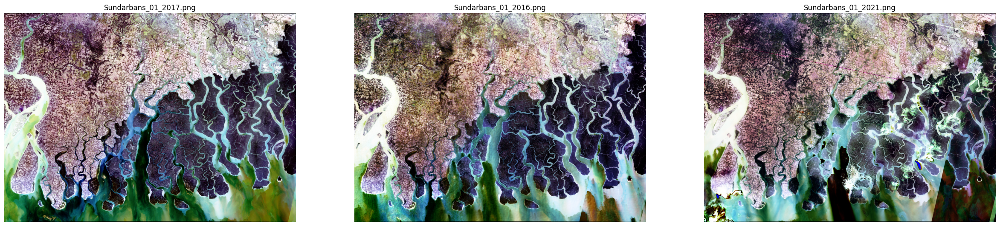

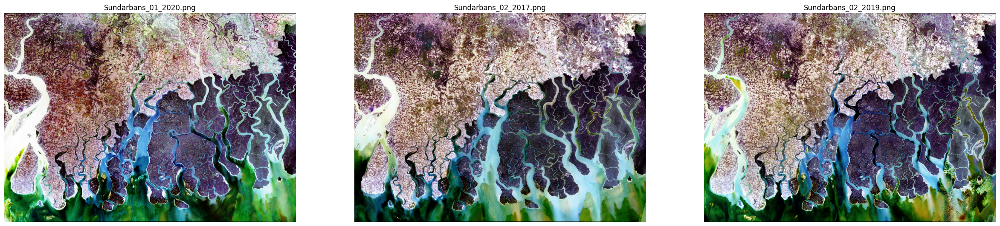

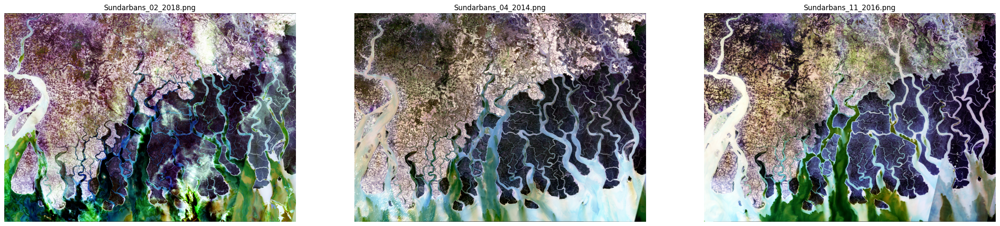

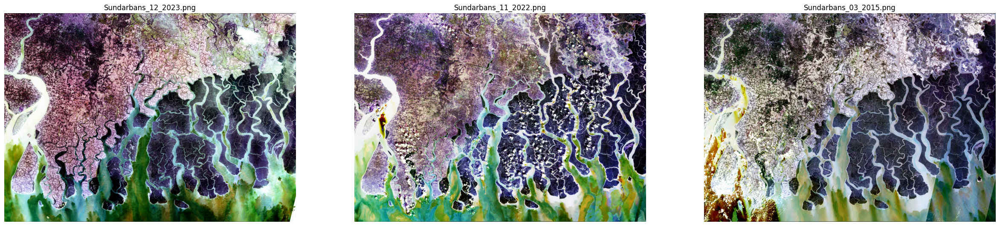

In [ ]:
pipe = ImageProcessingPipeline('/content/drive/MyDrive/Final/Sundarban_Kamalka_Images')
# Creates an instance of the `ImageProcessingPipeline` class.
# The constructor is initialized with the path to the directory containing the raw images.
# This object, named `pipe`, will now manage the image processing operations for the images in this specified directory.

pipe.apply_pipeline()
# Calls the `apply_pipeline` method on the `pipe` object.
# This method executes the full image enhancement pipeline defined within the `ImageProcessingPipeline` class.
# It sequentially applies histogram equalization, contrast stretching, and gamma correction
# to all images found in the `/content/drive/MyDrive/Final/Sundarban_Kamalka_Images` directory.
# The enhanced versions of these images are stored internally within the `pipe.enhanced_images` dictionary.

pipe.display_enhanced_images()
# Calls the `display_enhanced_images` method on the `pipe` object.
# This method visualizes the images that have been processed and stored by `apply_pipeline()`.
# It typically displays these enhanced images in a grid format using `matplotlib.pyplot`,
# allowing for a visual inspection of the improvements made by the pipeline.

Total Found Image :  12


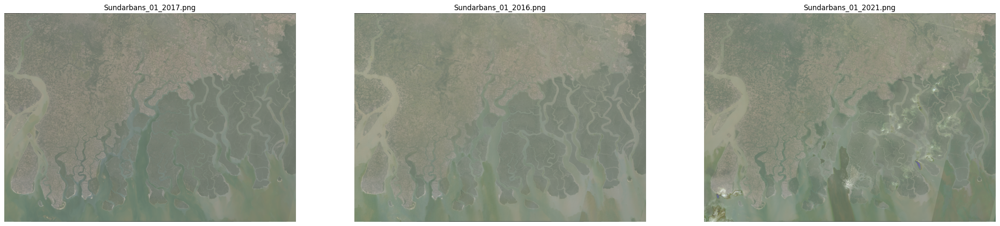

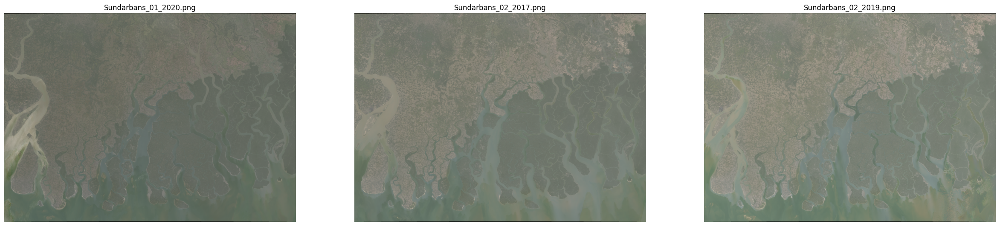

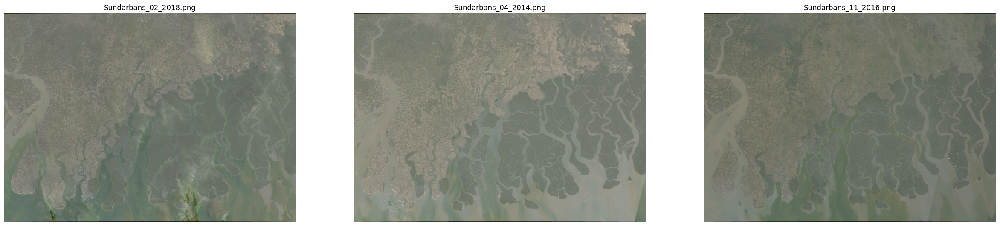

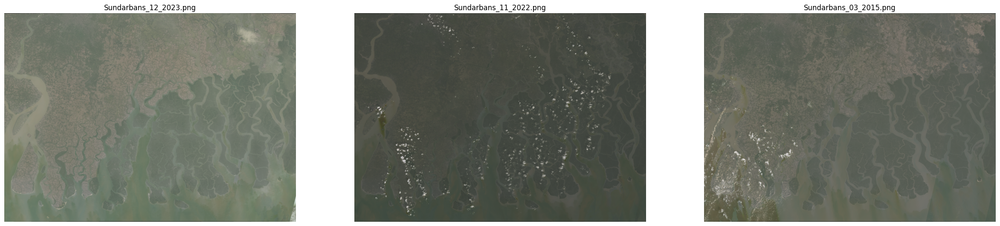

In [ ]:
pipe.display_raw_image()
# Calls the `display_raw_image` method on the `pipe` object.
# This method is used to visualize the **original, unenhanced** images located at the `image_path`
# that was provided during the `ImageProcessingPipeline` object's initialization.
# It displays these raw images in a grid format using `matplotlib.pyplot`,
# allowing for a visual comparison with the later enhanced or segmented images.

In [ ]:
pipe.save_file()
# Calls the `save_file` method on the `pipe` object.
# This method saves all the images that have been processed and stored in the `pipe.enhanced_images` dictionary.
# It creates a new folder named 'Enhanced-Image' (if it doesn't already exist) in the current working directory,
# and then writes each enhanced image into this folder, using their original filenames.

First layer KMeans done.
Sea surface removal done.
Dataset created.
Model13 done.
Selected from Model13 done.
New dataset of Model13 done.
Model16 done.
New dataset of Model16 done.
Entering image transformation loop...


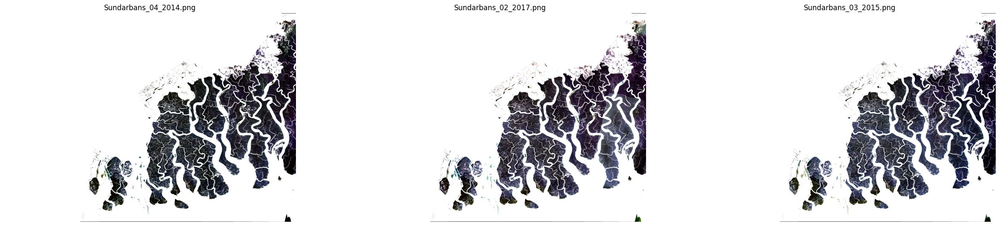

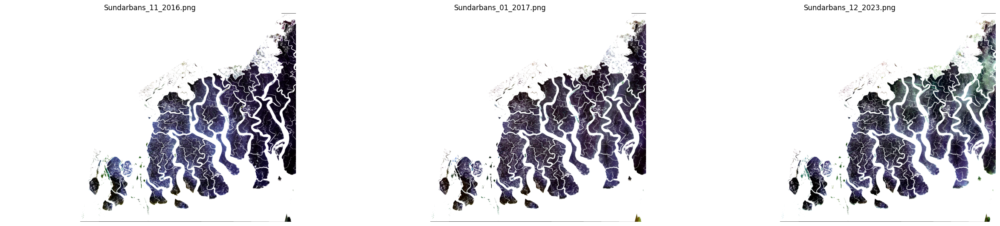

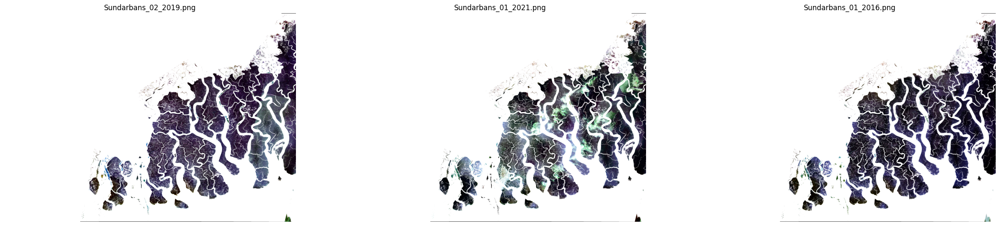

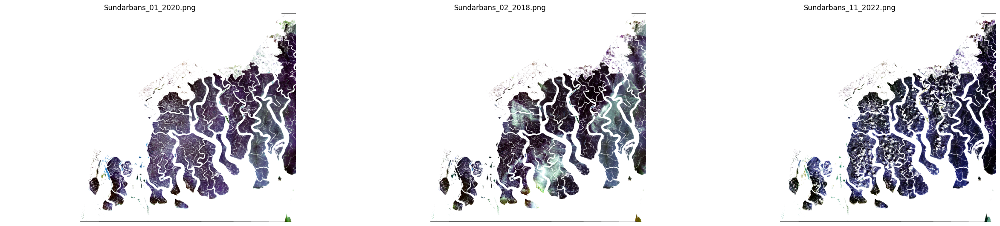

In [ ]:
enhanced_image = cv2.imread('/content/Enhanced-Image/Sundarbans_04_2014.png')
# Reads a specific enhanced image from the 'Enhanced-Image' directory.
# This assumes that `pipe.save_file()` has been executed previously, creating this directory and saving the enhanced images.
# The `cv2.imread()` function loads the image 'Sundarbans_04_2014.png' into the `enhanced_image` variable as a NumPy array (BGR format).

new_pipe = MultiLayerClustering(enhanced_image)
# Creates a new instance of the `MultiLayerClustering` class.
# The constructor is initialized with the `enhanced_image` that was just loaded.
# This `new_pipe` object is now ready to perform multi-layer segmentation on this specific image.

new_pipe.apply()
# Calls the `apply` method on the `new_pipe` object.
# This method initiates the entire multi-layer clustering pipeline as defined in the `MultiLayerClustering` class.
# It typically involves:
# 1. An initial K-Means clustering.
# 2. A sea surface removal step.
# 3. Creation of a dataset of relevant pixels.
# 4. Further layers of K-Means clustering (e.g., `model13` and `new_model16`) to refine the pixel selection.
# The results of these operations are used to identify and isolate the target region within the image.

new_pipe.display_segmented_images()
# Calls the `display_segmented_images` method on the `new_pipe` object.
# This method visualizes the final segmented images that resulted from the `new_pipe.apply()` process.
# It displays the images using `matplotlib.pyplot`, allowing you to see the extracted or highlighted regions.

In [ ]:
new_pipe.save_file()
# Calls the `save_file` method on the `new_pipe` object (an instance of `MultiLayerClustering`).
# This method saves all the segmented images that were generated and stored internally by `new_pipe.apply()`.
# It creates a new directory named 'Segmented-Image' (if it doesn't already exist) in the current working directory,
# and then writes each segmented image into this folder, using their original filenames.

Distribution of Raw Image : 


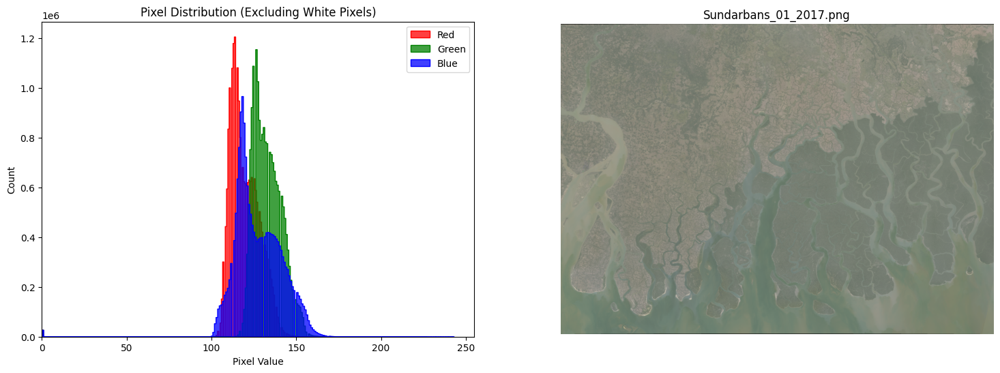

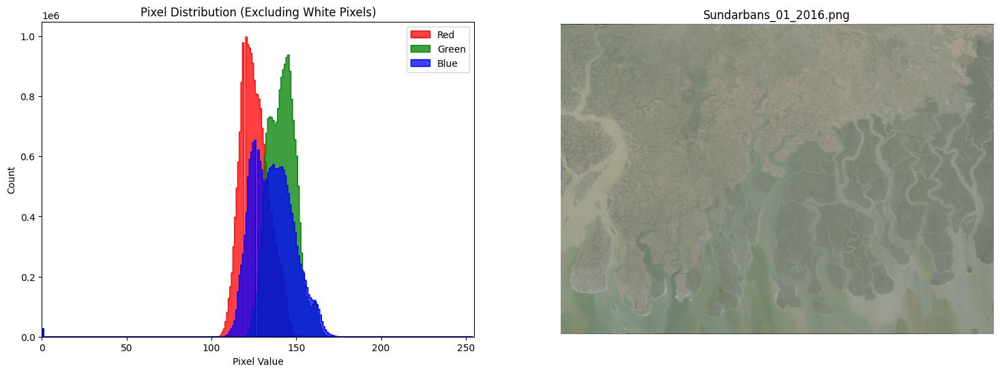

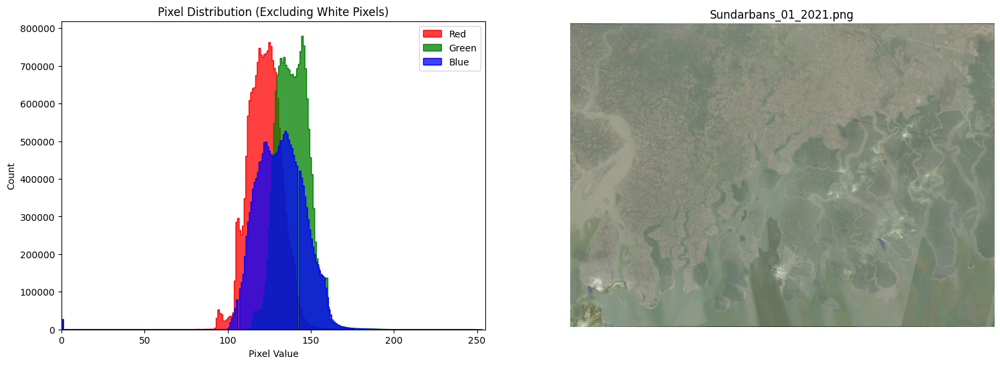

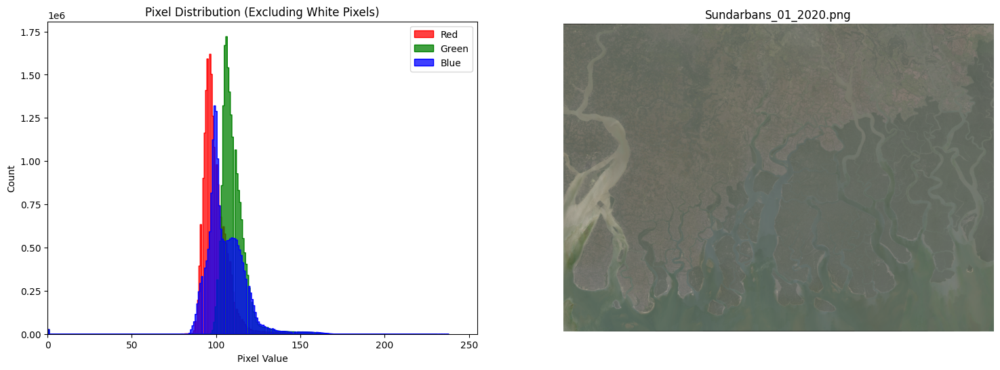

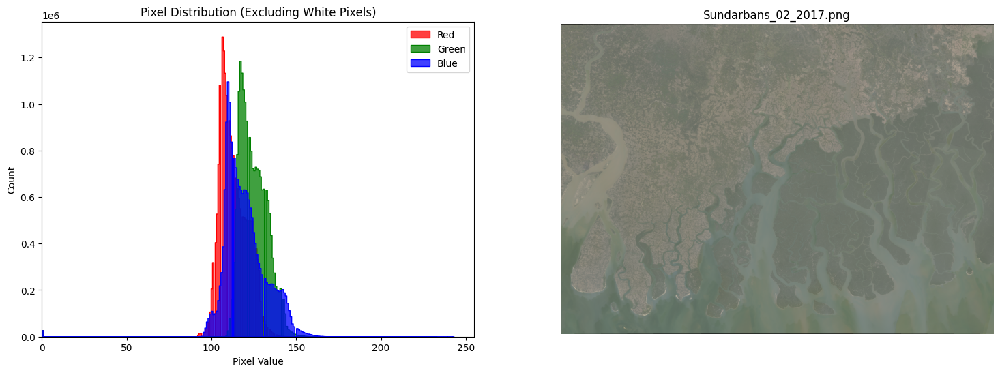

...

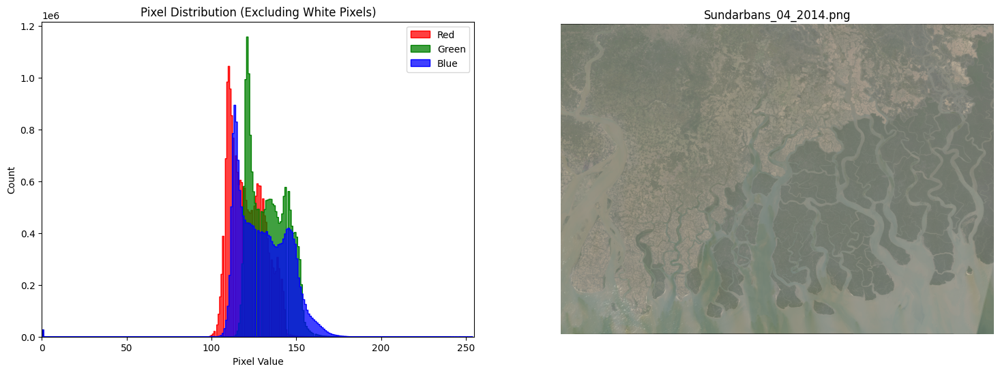

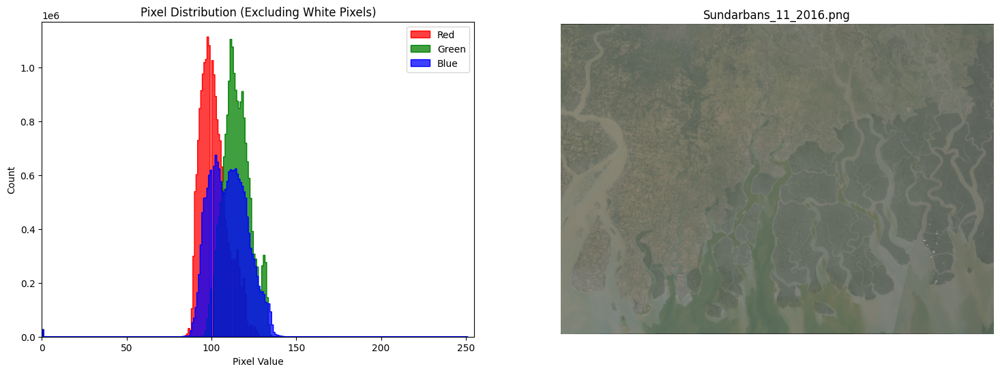

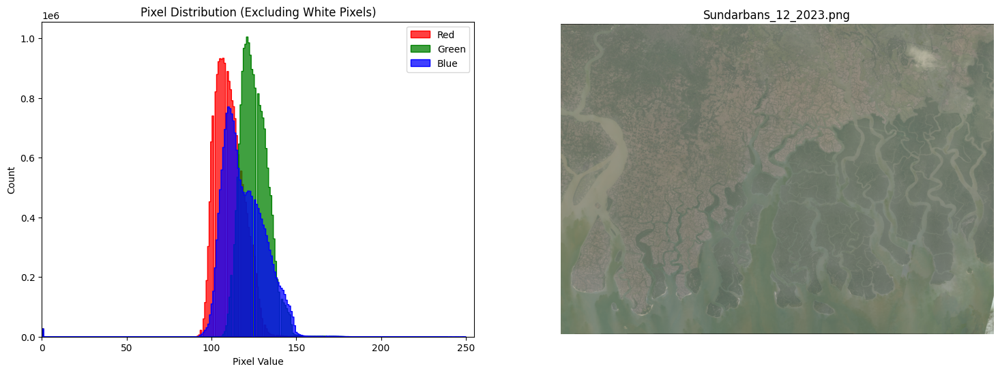

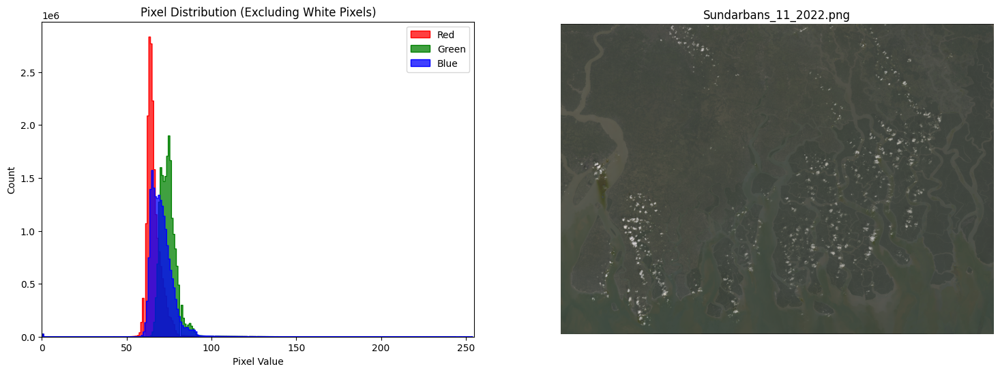

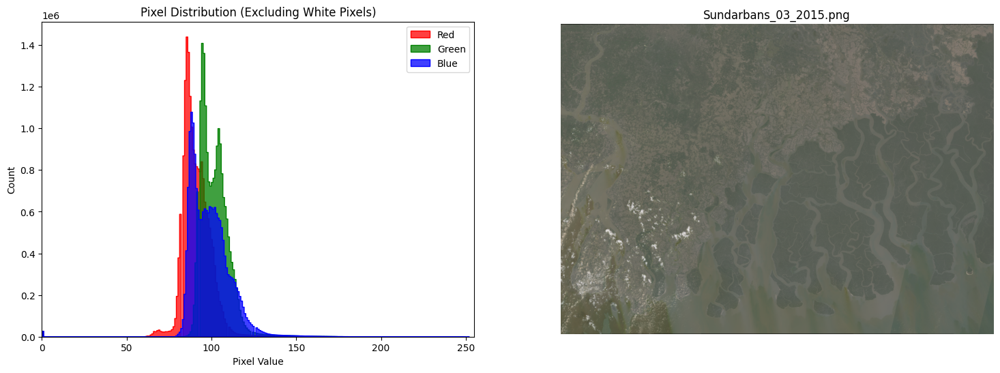

In [ ]:
ts0 = Analytics('/content/drive/MyDrive/Final/Sundarban_Kamalka_Images')
# Creates an instance of the `Analytics` class.
# The constructor is initialized with the path to the directory containing the **raw images**.
# This `ts0` object is now set up to perform analytical operations on the original images.

print("Distribution of Raw Image : ")
# Prints a descriptive message to the console, indicating that the following output will show the pixel distribution of the raw images.

ts0.pixel_distribution()
# Calls the `pixel_distribution` method on the `ts0` object.
# This method iterates through all images in the specified raw image directory.
# For each image, it calculates and displays the RGB pixel value distribution (histogram).
# Crucially, it filters out white pixels (pixel value 255) from the analysis,
# which is useful if the raw images have a white or near-white background that shouldn't be counted in the distribution of the actual subject.
# Each image's histogram plot is displayed alongside the image itself.

Distribution after segmentation : 


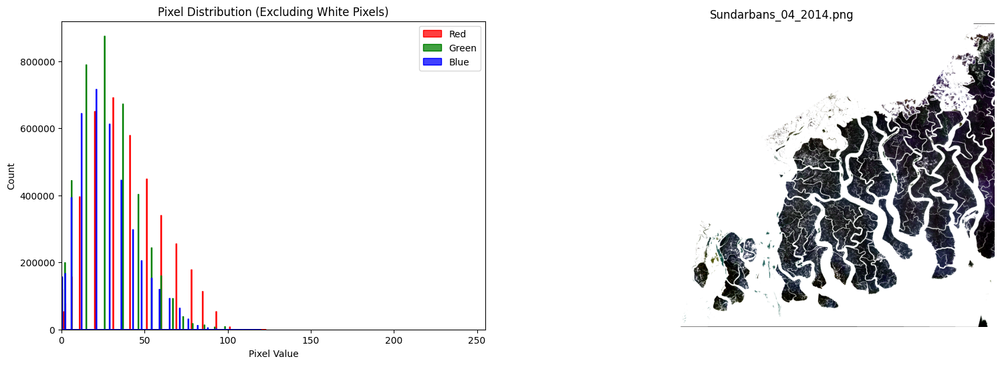

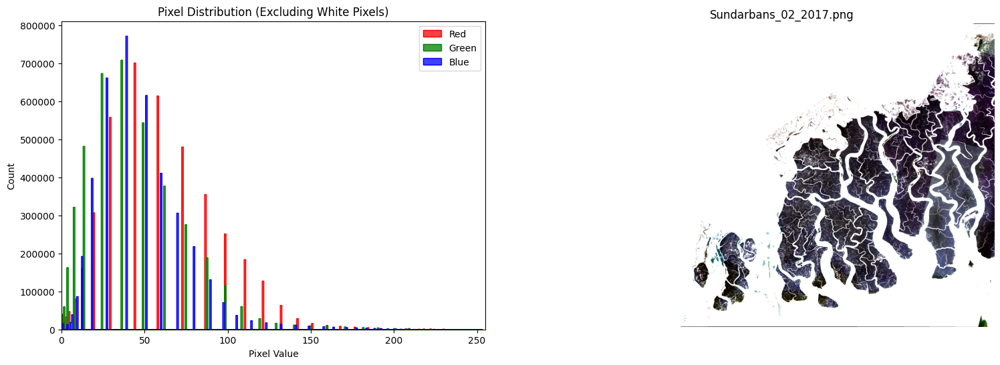

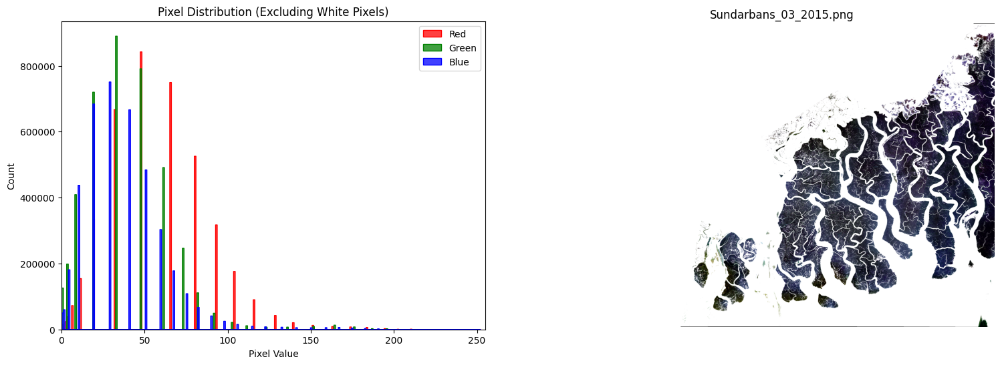

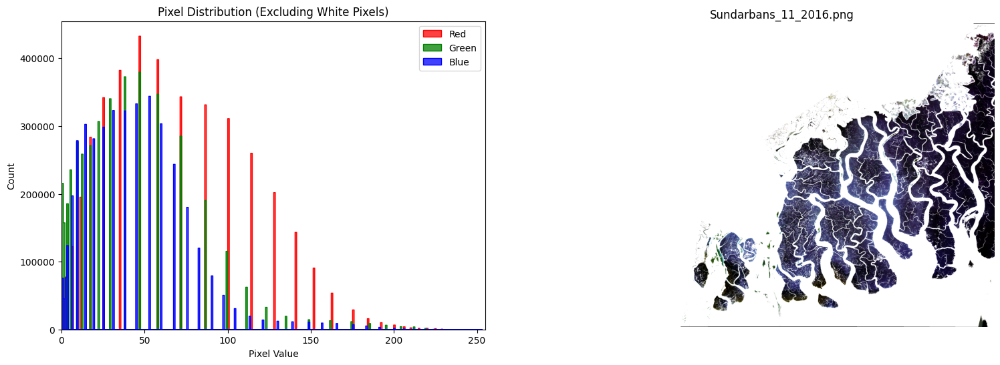

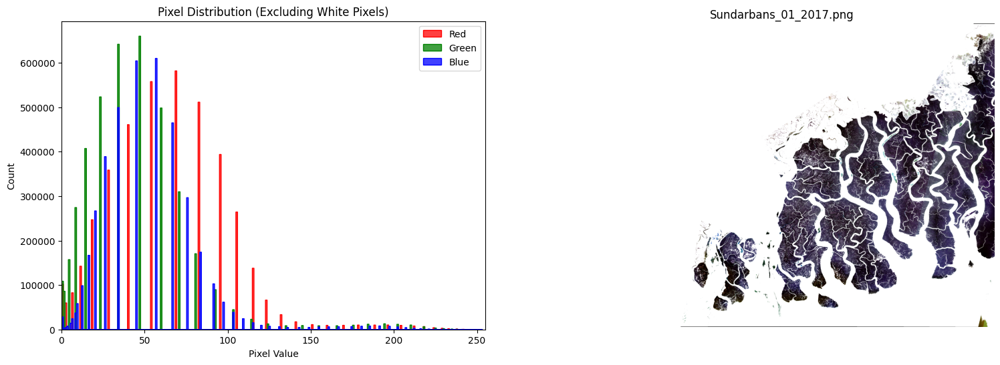

...

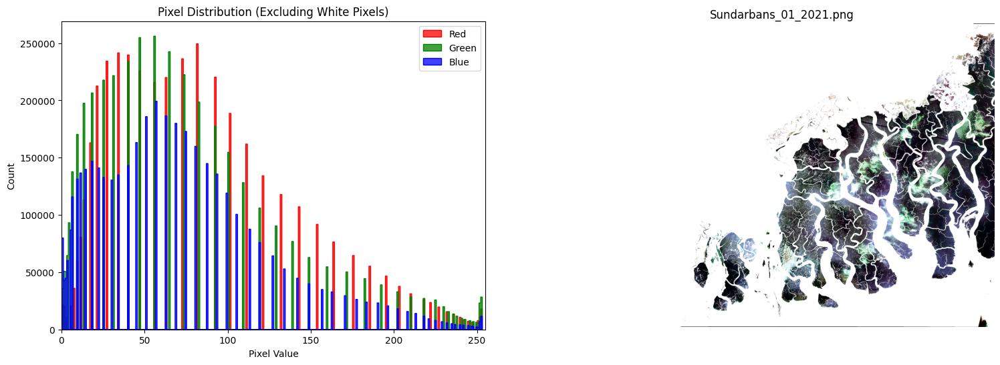

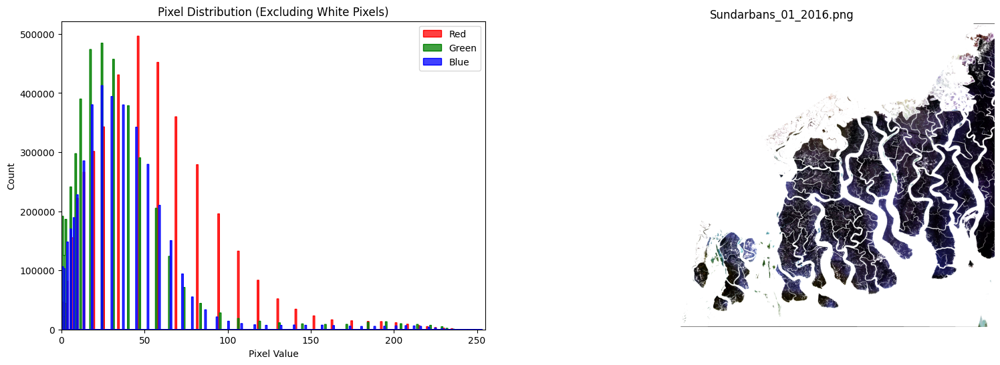

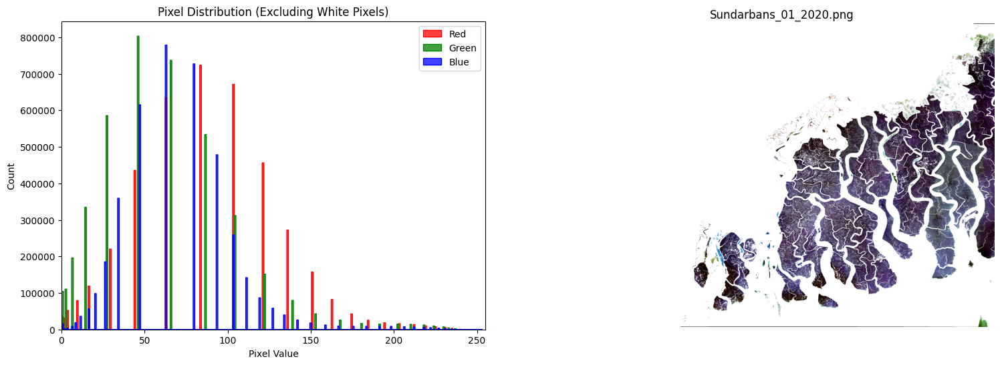

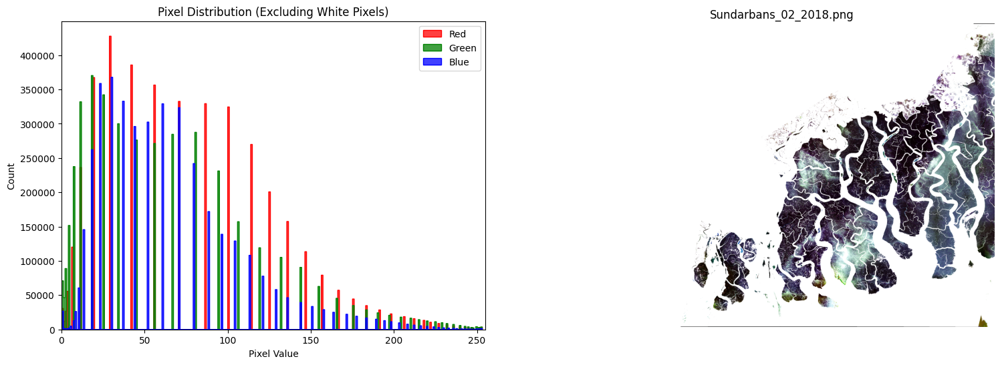

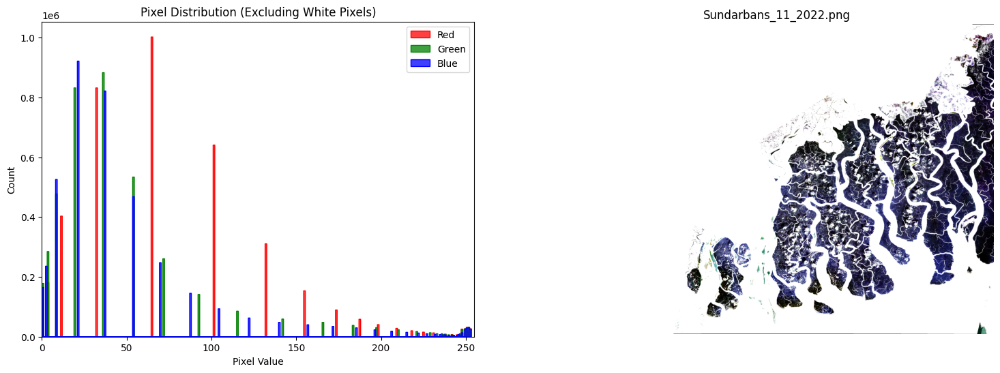

In [ ]:
ts = Analytics('/content/Segmented-Image')
# Creates a new instance of the `Analytics` class.
# This time, the constructor is initialized with the path to the directory containing the **segmented images**.
# This `ts` object is specifically configured to perform analytical operations on the output of the segmentation process.

print("Distribution after segmentation : ")
# Prints a descriptive message to the console, indicating that the following output will show the pixel distribution of the segmented images.

ts.pixel_distribution()
# Calls the `pixel_distribution` method on the `ts` object.
# This method iterates through all images in the 'Segmented-Image' directory.
# For each segmented image, it calculates and displays the RGB pixel value distribution (histogram).
# Similar to the raw image analysis, it excludes white pixels from the count.
# This visualization is particularly important here as it shows the color profile of the
# successfully segmented objects (e.g., land, fish, etc.), indicating if the segmentation
# process effectively isolated the target colors/regions from the background.
# Each segmented image's histogram plot is displayed alongside the image itself.

In [ ]:
results = ShowResult('/content/Segmented-Image')
# Creates an instance of the `ShowResult` class.
# The constructor is initialized with the path to the directory containing the **segmented images**.
# This `results` object is now configured to calculate and visualize the area of the segmented regions over time.

results.show_figure()
# Calls the `show_figure` method on the `results` object.
# This method first calls `calculate_area()` internally to:
#   1. Iterate through all images in the '/content/Segmented-Image' directory.
#   2. For each image, count the number of non-white pixels, which represents the segmented area.
#   3. Extract date information (month and year) from the image filenames.
#   4. Organize this area data by date.
# After calculating the areas, `show_figure()` then generates and displays an interactive line plot using Plotly.
# This plot visualizes the "pixel count" (representing the area) over time,
# providing a clear trend of changes in the segmented region.

In [ ]:
dataset = results.calculate_area()
# Calls the `calculate_area` method on the `results` object (an instance of `ShowResult`).
# This method computes the pixel count (representing the area) for each segmented image
# in the '/content/Segmented-Image' directory, based on the non-white pixels.
# It returns a dictionary where keys are sorted date strings (YYYY_MM) and values are the corresponding area pixel counts.
# This `dataset` dictionary will now serve as the input for the polynomial prediction model.

pr = PolynomialPrediction(dataset)
# Creates an instance of the `PolynomialPrediction` class.
# The constructor is initialized with the `dataset` (the historical area data) obtained from `results.calculate_area()`.
# This `pr` object is now set up to perform polynomial regression and make predictions based on this time-series data.

pr.model_training()
# Calls the `model_training` method on the `pr` object.
# This method performs the following key steps:
#   1. Converts the date strings in the `dataset` into a numerical representation suitable for regression.
#   2. Prepares the data for training, including potentially excluding some recent data points.
#   3. Initializes and trains a `LinearRegression` model using `PolynomialFeatures` (with a degree of 4, by default).
#   4. Stores the trained polynomial transformer (`poly`) and the linear regression model (`lr_model`) within the `pr` object.
#   5. Prints the approximate polynomial equation derived from the training.

inputx = ['2014_04',
 '2015_03',
 '2016_01',
 '2016_11',
 '2017_01',
 '2017_02',
 '2018_02',
 '2019_02',
 '2020_01',
 '2021_01',
 '2022_11',
 '2023_12',
 '2024_04',
 '2025_02',
 '2026_01',
]
# Defines a list of date strings (YYYY_MM) that represent the time points for which predictions are desired.
# This list includes historical dates present in the `dataset` as well as future dates (e.g., '2024_04', '2025_02', '2026_01')
# for forecasting the area trend.

pr.plot_prediction(inputx)
# Calls the `plot_prediction` method on the `pr` object, passing the `inputx` list.
# This method performs the following:
#   1. Calls `model_prediction()` internally to generate area predictions for each date in `inputx` using the trained polynomial model.
#   2. Generates an interactive line plot using Plotly.
#   3. Displays two lines on the plot:
#      - An 'Actual Line' showing the historical area data from the `dataset`.
#      - A 'Predicted Line' showing the model's predictions, including the forecasted future values, typically in a different color and style (e.g., dashed red).
#   4. Adds appropriate titles and axis labels to the plot.
# This visualization allows for a clear comparison between the actual historical trend and the model's fitted curve and future forecasts.

Final Equation --->> (-432.3602*x^1) + (-581853.9769*x^2) + (384.0099*x^3) + (-0.0713*x^4) + 395814177718.0010
